# Home Assignment No. 2: Part 2 (Practice)
To solve this task, you will write a lot of code to try several deep learning methods.
* You are **HIGHLY RECOMMENDED** to read relevant documentation, e.g. for [python](https://docs.python.org/3/), [numpy](https://docs.scipy.org/doc/numpy/reference/), [matlpotlib](https://matplotlib.org/) and [pytorch](https://pytorch.org/). Also remember that seminars, lecture slides, [Google](http://google.com) and [StackOverflow](https://stackoverflow.com/) are your close friends during this course (and, probably, whole life?).

* To do this part of homework, you have to write **CODE** directly inside specified places inside notebook **CELLS**.

* In some problems you may be asked to provide short discussion of the results. In this cases you have to create **MARKDOWN** cell with your comments right after the your code cell.

* For every separate (sub)problem you can get only 0 points or maximal points for this (sub)problem. There are **NO INTERMEDIATE scores**. So make sure that you did everything required in the task

* Your **SOLUTION** notebook **MUST BE REPRODUCIBLE**, i.e. if the reviewer decides to execute `Kernel` -> `Restart Kernel and Run All Cells`, after all the computation he will obtain exactly the same solution (with all the corresponding plots) as in your uploaded notebook. For this purpose, we suggest to fix random `seed` or (better) define `random_state=` inside every algorithm that uses some pseudorandomness.

* Your code must be clear to the reviewer. For this purpose, try to include neccessary comments inside the code. But remember: **GOOD CODE MUST BE SELF-EXPLANATORY** without any additional comments.

## Task 1. Deep ANNs. (5 points)

### Task 1.1.  Activation functions. (1 point)
Plot the following [activation functions](https://pytorch.org/docs/master/nn.html#non-linear-activation-functions) using their PyTorch realizations and their derivatives using [autograd](https://pytorch.org/docs/stable/autograd.html) functionality `grad()`:
   
1. **(1 pt.)** Plot `ReLU`, `ELU` ($\alpha = 1$), `Softplus` ($\beta = 1$) and `Sign`, `Sigmoid`, `Softsign`, `Tanh`.
Which of these functions may be, and which - definitely, are a poor choise as an activation function in a neural network? Why?

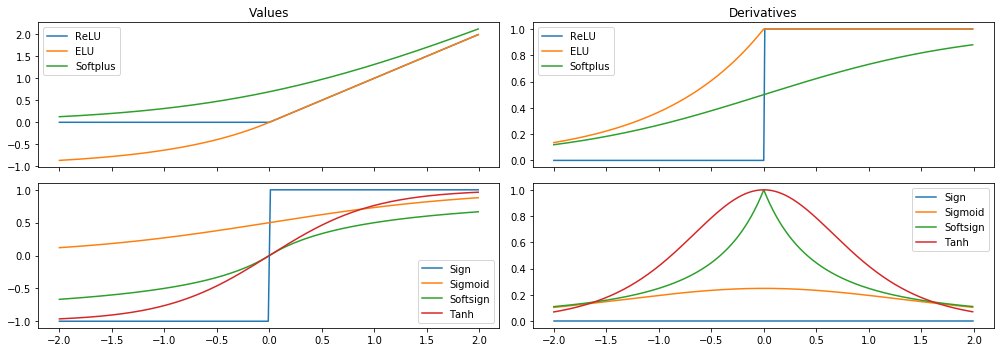

In [1]:
%matplotlib inline
import torch.nn.functional as F
import matplotlib.pyplot as plt
import torch

x = torch.arange(-2, 2, .01, requires_grad=True)
x_np = x.detach().numpy()
x.sum().backward() # to create x.grad

f, axes = plt.subplots(2, 2, sharex=True, figsize=(14, 5))
axes[0, 0].set_title('Values')
axes[0, 1].set_title('Derivatives')

for i, function_set in (0, (('ReLU', F.relu), ('ELU', F.elu), ('Softplus', F.softplus))), \
                       (1, (('Sign', torch.sign), ('Sigmoid', torch.sigmoid), ('Softsign', F.softsign), ('Tanh', torch.tanh))):
    for function_name, activation in function_set:
            y = activation(x)
            axes[i, 0].plot(x_np, y.detach().numpy(), label = function_name)
            x.grad.zero_()
            y.sum().backward()
            axes[i, 1].plot(x_np, x.grad, label = function_name)
    axes[i, 0].legend()
    axes[i, 1].legend()

plt.tight_layout()
plt.show()

### Task 1.2. MNIST classification. (4 points)

At the **[Seminar 13](https://github.com/adasegroup/ML2020_seminars/tree/master/seminar12)** on neural networks, we designed an MLP (Multilayer perceptron) with one hidden layer using our numpy implementations of linear layer, logistic and softmax activation functions. In this task, you are to

1. **(1 pt.)** Implement the MLP modules, including the Softmax cross entropy between `logits` and `labels`.
2. **(2 pt.)** Train our numpy realization of MLP to classify the MNIST from `sklearn.datasets()`. The required accuracy on validation is `> 90%`.
3. **(1 pt.)** Compare the acccuracy of classification to your scores from `Part 1` with and without dimensionality reduction. Is this comparison fair? :) Derive the confusion matrix for all digits classes. Which digits are predicted better or worse than others?

In [12]:
from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn.datasets import load_digits
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

In [3]:
# fetch the dataset.
digits, targets = load_digits(return_X_y=True)
digits = digits.astype(np.float32) / 255

digits_train, digits_test, targets_train, targets_test = train_test_split(digits, targets, random_state=0)

train_size = digits_train.shape[0]

input_size = 8*8
classes_n = 10

**Implement the MLP with backprop.**

In [8]:
class Linear:
    def __init__(self, input_size, output_size):
        self.thetas = np.random.randn(input_size, output_size)
        self.thetas_grads = np.empty_like(self.thetas)
        self.bias = np.random.randn(output_size)
        self.bias_grads = np.empty_like(self.bias)

    def forward(self, x):
        self.x = x
        output = np.matmul(x, self.thetas) + self.bias
        return output
    
    def backward(self, output_grad):
        # For weight recalculation
        self.thetas_grads += self.x.T @ output_grad
        self.bias_grads += output_grad.sum(axis=0)
        
        # New grad(error)
        input_grad = output_grad @ self.thetas.T
        return input_grad
    
    def zero_gradients(self):
        self.thetas_grads.fill(0.0)
        self.bias_grads.fill(0.0)

    def update_weights(self, rate):
        self.thetas -= self.thetas_grads * rate
        self.bias -= self.bias_grads * rate

class LogisticActivation:
    def forward(self, x):
        
        output = 1/(1 + np.exp(-x))
        self.sigmoid = output
        return output


    def backward(self, output_grad):
        input_grad = self.sigmoid * (1.0 - self.sigmoid) * output_grad
        return input_grad


class MLP:
    def __init__(self, input_size, hidden_layer_size, output_size):
        self.linear1 = Linear(input_size, hidden_layer_size)
        self.activation1 = LogisticActivation()
        self.linear2 = Linear(hidden_layer_size, output_size)
        
    
    def forward(self, x):
        return self.linear2.forward(self.activation1.forward(self.linear1.forward(x)))

    def backward(self, output_grad):
        output_from_linear2 = self.linear2.backward(output_grad)
        output_activation = self.activation1.backward(output_from_linear2)                
        output_from_linear1 = self.linear1.backward(output_activation)
        return output_from_linear1
    
    def zero_gradients(self):
        self.linear1.zero_gradients()
        self.linear2.zero_gradients()
    
    def update_weights(self, rate):
        self.linear1.update_weights(rate)
        self.linear2.update_weights(rate)

In [9]:

def softmax_crossentropy_with_logits(logits, target):
    eps=1e-10
    predictions = np.exp(logits)
    predictions = predictions/np.sum(logits)
    predictions = np.clip(logits, eps, 1. - eps)
    if len(target)==1:
        y = np.array([1 if i==target else 0 for i in range(10)])
    elif len(target)==10:
        y = target
    else:
        raise ValueError('len of target is not correct: ')
    
    entropy = -np.sum(y * np.log(predictions))
    return entropy


def grad_softmax_crossentropy_with_logits(logits, reference_answers):
    y = np.zeros((1, 10))
    y[np.arange(1), reference_answers] = 1
    delta = (logits - y)
    return delta

In [10]:
np.random.seed(0)

mlp = MLP(input_size=input_size, hidden_layer_size=100, output_size=classes_n)

epochs_n = 100
learning_curve = [0] * epochs_n
test_curve = [0] * epochs_n

x_train = digits_train
x_test = digits_test
y_train = targets_train
y_test = targets_test

learning_rate = 8e-1

learning_rates = [0.8*(0.98**i) for i in range(epochs_n)]

for epoch in range(epochs_n):
    
    y_pred_train = []
    learning_rate = learning_rates[epoch-1]
    
    for sample_i in range(train_size):
        x = x_train[sample_i].reshape((1, -1))
        target = np.array([y_train[sample_i]])
        
        # Make gradient zero
        mlp.zero_gradients()
        
        # Forward
        logits = mlp.forward(x)
        y_pred_train.append(logits.argmax())

        loss = softmax_crossentropy_with_logits(logits, target)
        learning_curve[epoch] += loss
        
        ## Calculate gradients
        output_grad = grad_softmax_crossentropy_with_logits(logits, target)
        mlp.backward(output_grad)
        
        # Undate weight
        mlp.update_weights(learning_rate)
        
    learning_curve[epoch] /= train_size
    prediction = mlp.forward(x_test)
    loss = np.array(list(map(softmax_crossentropy_with_logits, prediction, y_test.reshape(-1,1))))
    y_pred_test = np.array(list(map(np.argmax, prediction)))
    test_curve[epoch] = np.mean(loss)
    if epoch % 10 == 0:
        print('Starting epoch {}'.format(epoch),', Accuracy on train: ', "%.2f" % accuracy_score(y_train, y_pred_train), ' Accuracy on test: ', "%.2f" % accuracy_score(y_test, y_pred_test))
        print()
print('Starting epoch {}'.format(epoch),', Accuracy on train: ', "%.2f" % accuracy_score(y_train, y_pred_train), ' Accuracy on test: ', "%.2f" % accuracy_score(y_test, y_pred_test))    
        

Starting epoch 0 , Accuracy on train:  0.15  Accuracy on test:  0.20

Starting epoch 10 , Accuracy on train:  0.68  Accuracy on test:  0.58

Starting epoch 20 , Accuracy on train:  0.85  Accuracy on test:  0.84

Starting epoch 30 , Accuracy on train:  0.90  Accuracy on test:  0.91

Starting epoch 40 , Accuracy on train:  0.92  Accuracy on test:  0.94

Starting epoch 50 , Accuracy on train:  0.94  Accuracy on test:  0.95

Starting epoch 60 , Accuracy on train:  0.95  Accuracy on test:  0.95

Starting epoch 70 , Accuracy on train:  0.96  Accuracy on test:  0.96

Starting epoch 80 , Accuracy on train:  0.96  Accuracy on test:  0.96

Starting epoch 90 , Accuracy on train:  0.96  Accuracy on test:  0.96

Starting epoch 99 , Accuracy on train:  0.96  Accuracy on test:  0.96


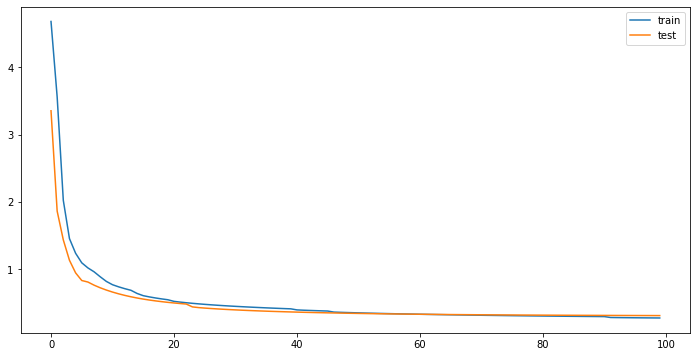

In [11]:
fig = plt.figure(figsize=(12,6))
plt.plot(learning_curve, label='train')
plt.plot(test_curve, label='test')
plt.legend()

In [12]:
# confusion matrix
y_pred_test = np.array(list(map(np.argmax, mlp.forward(digits))))
pd.DataFrame(confusion_matrix(targets, y_pred_test))

,0,1,2,3,4,5,6,7,8,9
0,178,0,0,0,0,0,0,0,0,0
1,0,179,0,0,0,1,1,0,1,0
2,0,1,176,0,0,0,0,0,0,0
3,0,1,1,171,0,1,0,3,5,1
4,0,2,0,0,176,0,0,1,2,0
5,0,0,0,0,0,177,1,0,0,4
6,0,2,0,0,0,1,177,0,1,0
7,0,0,0,0,1,0,0,177,0,1
8,0,7,1,1,0,2,1,0,162,0
9,0,1,0,1,1,2,0,5,5,165


### Compare the acccuracy of classification to your scores from Part 1 with and without dimensionality reduction

### Accuracy on test MLP:  0.96

### Accuracy with dim. reduction

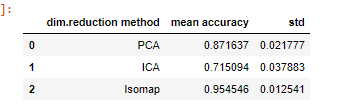

In [236]:
from IPython.display import Image
Image("acc.png")

### Accuracy without dim reduction

0.9682750438460743

### Why it can be not fair? This question is not clear, we implement 2 different methods. Yes in part 1 we use cross_val_score, here we use score on test set, (logreg from part 1 have more data to train), but this two fair estimates of model accuracy.

## Task 2. Autoencoders. (7 points)

### Task 2.1.  Autoencoder on the tabular data. (3 points)


We will build a latent representation for tabular data with simple Autoencoder (AE). We are going to work with the cancer dataset from scikit-learn package. You are to follow the instructions `1.0 - 1.6`.  

1. **(1 pt.)** Implement AE modules;
2. **(2 pt.)** Train AE to get latent representation of the cancer dataset from `sklearn.datasets()`. Use `MSE` loss and get < $0.28$ on validation, with AE "bottleneck" = $2$;
3. **(1 pt.)** Plot the latent representation of whole dataset in 2D, use colors to show object of differneet classes;

In [1]:
# imports
import sklearn.datasets as sk_data
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler

import torch
import torch.nn as nn
import torch.utils.data as torch_data

#### 1.0 Featch the data. Scale it and split on train and test.

In [2]:
cancer_dset = sk_data.load_breast_cancer()

X = StandardScaler().fit_transform(cancer_dset['data'])

print('Features: ', list(cancer_dset['feature_names']))
print('\nShape:', X.shape)

X_train, X_val, y_train, y_val = train_test_split(X, cancer_dset['target'], test_size=0.2, random_state=42)
print('\nTrain size: ', len(X_train))
print('Validation size: ', len(X_val))

Features:  ['mean radius', 'mean texture', 'mean perimeter', 'mean area', 'mean smoothness', 'mean compactness', 'mean concavity', 'mean concave points', 'mean symmetry', 'mean fractal dimension', 'radius error', 'texture error', 'perimeter error', 'area error', 'smoothness error', 'compactness error', 'concavity error', 'concave points error', 'symmetry error', 'fractal dimension error', 'worst radius', 'worst texture', 'worst perimeter', 'worst area', 'worst smoothness', 'worst compactness', 'worst concavity', 'worst concave points', 'worst symmetry', 'worst fractal dimension']

Shape: (569, 30)

Train size:  455
Validation size:  114


#### 1.1 Let us firtly create the dataset, which we'll be able to use with pytorch dataloader. 
Implement `__len__` and `__getitem__` methods.

In [3]:
class CancerData(torch_data.Dataset):
    def __init__(self, X, y):
        super(CancerData, self).__init__()
        self.X = torch.tensor(X, dtype=torch.float32)
        self.y = torch.tensor(y, dtype=torch.float32)
    
    def __len__(self):
        return self.X.shape[0]
    
    def __getitem__(self, idx):
        return self.X[idx], self.y[idx]

In [4]:
train_dset = CancerData(X_train, y_train) 
val_dset = CancerData(X_val, y_val) 

print(train_dset[5])

(tensor([ 0.1172,  1.9199,  0.1961,  0.0111,  1.2482,  1.0453,  0.9429,  0.6376,
         1.7940,  1.1302, -0.1269, -0.3336,  0.0064, -0.1713, -0.4780,  0.9458,
         0.5145, -0.1454, -0.2388,  0.6321,  0.2466,  1.8650,  0.5016,  0.1101,
         1.5532,  2.5664,  2.0649,  0.8617,  2.1310,  2.7793]), tensor(0.))


#### 1.2 Now, we'll make a base class for our autoencoder. 
AE takes as input encoder and decoder (it will be two neural networks). Your task is to implement the forward pass.

In [96]:
class MyFirstAE(nn.Module):
    def __init__(self, encoder, decoder):
        super(MyFirstAE, self).__init__()
        self.encoder = encoder
        self.decoder = decoder
    
    def forward(self, x):
        """
        Take a mini-batch as an input, encode it to the latent space and decode back to the original space
        x_out = decoder(encoder(x))
        :param x: torch.tensor, (MB, x_dim)
        :return: torch.tensor, (MB, x_dim)
        """
        z = self.encoder(x)
        out = self.decoder(z)
        return out

#### 1.3 It is high time to create encoder an decoder neural networks!
Make hidden size of the network to be equal to `2`.

**Hint.** You can use `nn.Sequential` to create your own archtectures.

In [272]:
initial_size = 30
dr =0

bn_size = 2
s1, s2, s3 = 64, 16, 8

In [273]:
encoder = nn.Sequential(

                        nn.Linear(initial_size, s1),
                        nn.BatchNorm1d(s1),
                        nn.ReLU(inplace=True),
                        nn.Dropout(dr),
                        nn.Linear(s1, s2),
                        nn.BatchNorm1d(s2),
                        nn.ReLU(inplace=True),
                        nn.Dropout(dr),
                        nn.Linear(s2, s3),
                        nn.BatchNorm1d(s3),    
                        nn.ReLU(inplace=True),
                        nn.Dropout(dr),
                        nn.Linear(s3, bn_size),
                        )  

decoder = nn.Sequential(
                        nn.Linear(bn_size, s3),
                        nn.BatchNorm1d(s3),
                        nn.ReLU(inplace=True),
                        nn.Dropout(dr),
                        nn.Linear(s3, s2),
                        nn.BatchNorm1d(s2),
                        nn.ReLU(inplace=True),
                        nn.Dropout(dr),
                        nn.Linear(s2, s1),
                        nn.BatchNorm1d(s1),
                        nn.ReLU(inplace=True),
                        nn.Dropout(dr),
                        nn.Linear(s1, initial_size),
                        )

In [274]:
(0.66)**10

0.015683368809107964

In [275]:
device = 'cpu'

net = MyFirstAE(encoder, decoder)  
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(net.parameters(), lr = 0.04)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.9)


train_loader = torch_data.DataLoader(train_dset, batch_size=100, shuffle=True) 
val_loader = torch_data.DataLoader(val_dset, batch_size=100, shuffle=False) 

#### 1.4 Implement the missing parts of the `train` function

In [276]:
def train(epochs, net, criterion, optimizer, train_loader, val_loader,scheduler=None, verbose=True, save_dir=None):
    np.random.seed(0)
    net.to(device)
    for epoch in range(1, epochs+1):
        net.train()
        for X, _ in train_loader:
            # Perform one step of minibatch stochastic gradient descent
            out = net(X)
            loss = criterion(out, X)
            
            optimizer.zero_grad()
            
            loss.backward()
            optimizer.step()
        
        # define NN evaluation, i.e. turn off dropouts, batchnorms, etc.
        net.eval()
        for X, _ in val_loader:
            # Compute the validation loss
            X = X.to(device)
            out = net(X)
            val_loss = criterion(out, X)
            # >>> your solution here <<<
         
        if scheduler is not None:
            scheduler.step()
        freq = max(epochs//20,1)
        if verbose and epoch%freq==0:
            print('Epoch {}/{} || Loss:  Train {:.4f} | Validation {:.4f}'.format(epoch, epochs, loss.item(), val_loss.item()))

#### 1.5 Train your AE on breast cancer dataset. 
Your goal is to get validation error <0.3.

Some features that may help you to improve the performance:
* `Dropout`
* `Batchnorm`
* lr scheduler
* Batch size increase/decrease

In [277]:
train(100, net, criterion, optimizer, train_loader, val_loader, scheduler) 

Epoch 5/100 || Loss:  Train 0.5725 | Validation 1.2764
Epoch 10/100 || Loss:  Train 0.4513 | Validation 0.4473
Epoch 15/100 || Loss:  Train 0.5245 | Validation 0.4156
Epoch 20/100 || Loss:  Train 0.2958 | Validation 0.4782
Epoch 25/100 || Loss:  Train 0.2879 | Validation 0.3571
Epoch 30/100 || Loss:  Train 0.2986 | Validation 0.3173
Epoch 35/100 || Loss:  Train 0.3948 | Validation 0.2988
Epoch 40/100 || Loss:  Train 0.2890 | Validation 0.3016
Epoch 45/100 || Loss:  Train 0.3330 | Validation 0.2874
Epoch 50/100 || Loss:  Train 0.3243 | Validation 0.2880
Epoch 55/100 || Loss:  Train 0.3117 | Validation 0.2977
Epoch 60/100 || Loss:  Train 0.3352 | Validation 0.2818
Epoch 65/100 || Loss:  Train 0.2647 | Validation 0.2638
Epoch 70/100 || Loss:  Train 0.3349 | Validation 0.2601
Epoch 75/100 || Loss:  Train 0.2320 | Validation 0.2537
Epoch 80/100 || Loss:  Train 0.3490 | Validation 0.2632
Epoch 85/100 || Loss:  Train 0.2860 | Validation 0.2622
Epoch 90/100 || Loss:  Train 0.2423 | Validation 

#### 1.6 Let us take a look at the latent space. 
Encode the whole dataset, using your AE, plot it in 2D and use colors to indicate objects of differrent classes

In [278]:
enc = net.encoder(torch.tensor(X, dtype=torch.float32)).detach().numpy() ## detach() - make copy of tensor that not requirer grad

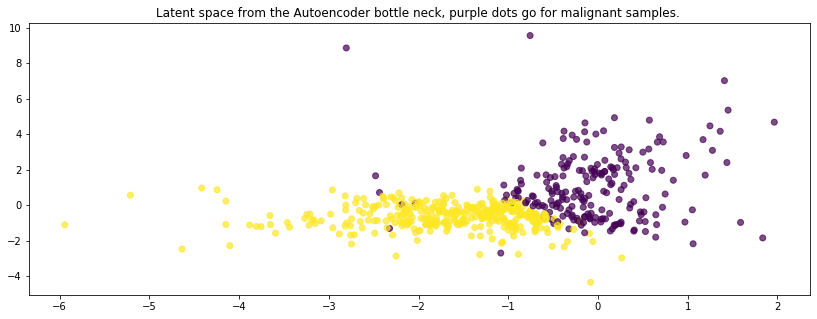

In [279]:
 ### BEGIN Solution
plt.figure(figsize=(14, 5))
net.eval()
enc = enc
plt.scatter(enc[:,0], enc[:,1], c=cancer_dset['target'], alpha=0.7);
plt.title('Latent space from the Autoencoder bottle neck, purple dots go for malignant samples. ');
 ### END Solution

### Task 2.2.  Autoencoder on kMNIST. (4 points)


We will build a latent representation for `kMRIST` dataset by using our AE. We will work with the data from `Part 1`.

1. **(2 pt.)** Train AE to get latent representation of the `kMNIST` dataset from `sklearn.datasets()`. Follow the instructions `2.0 - 2.4`. Use `MSE` loss and obtain < $0.035$ on validation, with AE "bottleneck"  $\leq 40$;
2. **(1 pt.)** Plot 10 images and their reconstructions. Plot the latent representation of the whole dataset in 3D, compare visually to your manifold from `Part 1` and upload (pictures) screenshots to this notebook.
3. **(1 pt.)** Get the classification accuracy for the latent features. Use the `KNN` classifier with any hyperparameters you like. Write a couple of sentences about the differences of `manifold learning` and ` AE` results. 
3. **(BONUS 3 pt.)** Sampling from latent representation.

In [280]:
def load(f):
    return np.load(f)['arr_0']

# Load the data
x_train = load('data/kmnist/kmnist-train-imgs.npz')
x_test = load('data/kmnist/kmnist-test-imgs.npz')
y_train = load('data/kmnist/kmnist-train-labels.npz')
y_test = load('data/kmnist/kmnist-test-labels.npz')



In [281]:
# Reshape the data and scale

x_train = x_train/255
x_test = x_test/255
x_train = torch.tensor(x_train, dtype=torch.float32)
x_test = torch.tensor(x_test, dtype=torch.float32)

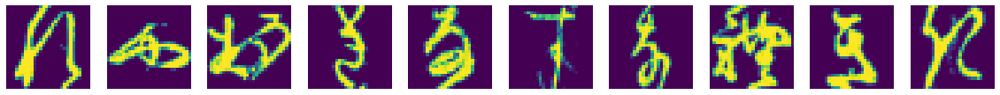

In [282]:
fig, ax = plt.subplots(ncols=10, figsize=(20, 5))
for i in range(10):
    ax[i].imshow(x_train[i].reshape(28,28));
    ax[i].axis('off')

In [283]:
class kMNISTData(torch_data.Dataset):
    def __init__(self, X, y):
        super(kMNISTData, self).__init__()
        self.X = torch.as_tensor(X, dtype=torch.float32)
        self.y = torch.as_tensor(y, dtype=torch.float32)
    
    def __len__(self):
        return self.X.shape[0]
    
    def __getitem__(self, idx):
        return self.X[idx].unsqueeze(0), self.y[idx]

In [284]:
train_kmnist = kMNISTData(x_train, y_train) 
test_kmnist = kMNISTData(x_test, y_test)

In [285]:
np.shape(train_kmnist[0][0])

torch.Size([1, 28, 28])

#### 2.0 Create encoder and decoder network for kMNIST. 
You can either use convolutions or flatten the images and use linear layers. You can choose hidden size (not larger than 40) and any architecture you like.

In [286]:
w=12
f=3
p=0
s=2
(w-f+2*p)//s + 1 

5

In [287]:
class nn_reshape(nn.Module):
    def __init__(self, *args):
        super(nn_reshape, self).__init__()
        self.shape = args

    def forward(self, x):
        return x.view(-1, *self.shape)

In [288]:
dr=0

In [289]:
encoder = lambda hidden_size : nn.Sequential(
                        nn.Conv2d(1, 1, 3, 1, 1),
                        nn.BatchNorm2d(1),
                        nn.ReLU(inplace=True),
                        nn.Dropout(dr),
                        
                        nn.Flatten(),
    
                        nn.Linear(28*28, 196),
                        nn.BatchNorm1d(196),
                        nn.ReLU(inplace=True),
                        nn.Dropout(dr),
                        
                        nn.Linear(196, hidden_size),
                        )  

decoder = lambda hidden_size : nn.Sequential(
                        nn.Linear(hidden_size, 196),
                        nn.BatchNorm1d(196),
                        nn.ReLU(inplace=True),
                        nn.Dropout(dr),
                        
                        nn.Linear(196, 28*28),
                        nn.BatchNorm1d(28*28),
                        nn.ReLU(inplace=True),
                        nn.Dropout(dr),
                        
                        nn_reshape(1,28,28),
                        
                        nn.Conv2d(1, 1, 3, 1, 1),
                        nn.BatchNorm2d(1),
                        nn.ReLU(inplace=True),
                        )

#### 2.1 Train AE on the kMNIST. 
Your goal is to obtain MSE on the test set < $0.035$ on `MyFirstAE(encoder(40), decoder(40))`.

In [290]:
device = 'cpu'

net = MyFirstAE(encoder(40), decoder(40)) 
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(net.parameters(), lr = 2e-3)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.8)


train_loader = torch_data.DataLoader(train_kmnist, batch_size=500, shuffle=True) 
val_loader = torch_data.DataLoader(test_kmnist, batch_size=500, shuffle=False) 

In [291]:
epochs = 50
train(epochs, net, criterion, optimizer, train_loader, val_loader, scheduler)

Epoch 2/50 || Loss:  Train 0.0411 | Validation 0.0445
Epoch 4/50 || Loss:  Train 0.0290 | Validation 0.0342
Epoch 6/50 || Loss:  Train 0.0257 | Validation 0.0311
Epoch 8/50 || Loss:  Train 0.0254 | Validation 0.0296
Epoch 10/50 || Loss:  Train 0.0243 | Validation 0.0287
Epoch 12/50 || Loss:  Train 0.0236 | Validation 0.0280
Epoch 14/50 || Loss:  Train 0.0225 | Validation 0.0274
Epoch 16/50 || Loss:  Train 0.0220 | Validation 0.0271
Epoch 18/50 || Loss:  Train 0.0212 | Validation 0.0263
Epoch 20/50 || Loss:  Train 0.0216 | Validation 0.0261
Epoch 22/50 || Loss:  Train 0.0219 | Validation 0.0257
Epoch 24/50 || Loss:  Train 0.0210 | Validation 0.0255
Epoch 26/50 || Loss:  Train 0.0199 | Validation 0.0253
Epoch 28/50 || Loss:  Train 0.0203 | Validation 0.0251
Epoch 30/50 || Loss:  Train 0.0196 | Validation 0.0250
Epoch 32/50 || Loss:  Train 0.0201 | Validation 0.0246
Epoch 34/50 || Loss:  Train 0.0205 | Validation 0.0245
Epoch 36/50 || Loss:  Train 0.0202 | Validation 0.0244
Epoch 38/50 ||

#### 2.2 Plot any 10 images and their reconstructions.

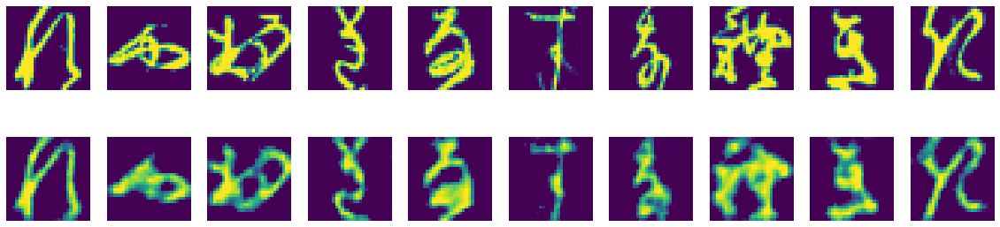

In [292]:
fig, ax = plt.subplots(ncols=10, nrows=2, figsize=(20, 5))
for i in range(10):
    im = train_kmnist[i][0]
    rec = net(im.reshape(1,1,28,28)).detach().numpy()
    ax[0, i].imshow(im[0].reshape(28,28));
    ax[1, i].imshow(rec[0].reshape(28,28));
    ax[0, i].axis('off')
    ax[1, i].axis('off')

#### 2.3 Plot the latent representation of whole dataset in 3D, compare visually to your manifold from `Part 1` and upload (pictures) screenshoots to this notebook.

In [293]:
import plotly
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import plotly.graph_objs as go
import colorlover as cl

In [294]:
def plot_points(points, title = 'kMNIST visualization PCA'):
    digits_3d = pd.DataFrame({
        'x': points[:, 0], 
        'y': points[:, 1], 
        'z': points[:, 2],
        'label': y_train,
    })

    colors = cl.scales['10']['qual']['Paired']
    _data = []

    for i in range(10):
        x = digits_3d[digits_3d['label'].astype('int') == i]['x']
        y = digits_3d[digits_3d['label'].astype('int') == i]['y']
        z = digits_3d[digits_3d['label'].astype('int') == i]['z']

        color = colors[i]

        trace = {
            'name': str(i),
            'x': x,
            'y': y,
            'z': z,
            'type': 'scatter3d',
            'mode': 'markers',
            'marker': {
                'size': 5,
                'color': color 
            }
        }
        _data.append(trace)

    layout = go.Layout(
        title=title,
        width=900,
        height=600
    )

    fig = go.Figure(data=_data, layout=layout)

    iplot(fig, show_link = False)

In [295]:
from sklearn.decomposition import PCA

In [296]:
pca = PCA(n_components=3)

In [297]:
X_for_pca = net.encoder(x_train.reshape([60000,1, 28, 28])).detach().numpy()

In [298]:
X_for_pca.shape

(60000, 40)

In [176]:
S_pca_ =StandardScaler().fit_transform(pca.fit_transform(X_for_pca_reshaped)) 

In [299]:
plot_points(X_for_pca, title='kMNIST visualization Autoencoder(40)+ PCA(3)')

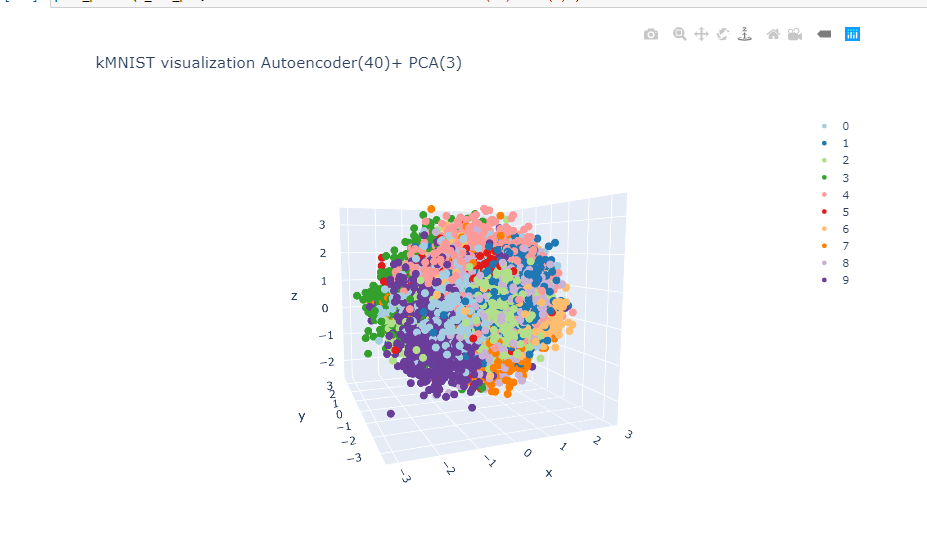

In [302]:
from IPython.display import Image
Image("ae_pca.png")

In [300]:
net3 = MyFirstAE(encoder(3), decoder(3)) 
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(net3.parameters(), lr = 2e-3)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.8)


train_loader = torch_data.DataLoader(train_kmnist, batch_size=500, shuffle=True) 
val_loader = torch_data.DataLoader(test_kmnist, batch_size=500, shuffle=False) 

In [301]:
epochs = 50
train(epochs, net3, criterion, optimizer, train_loader, val_loader, scheduler)

Epoch 2/50 || Loss:  Train 0.0835 | Validation 0.0885
Epoch 4/50 || Loss:  Train 0.0779 | Validation 0.0816
Epoch 6/50 || Loss:  Train 0.0749 | Validation 0.0796
Epoch 8/50 || Loss:  Train 0.0745 | Validation 0.0787
Epoch 10/50 || Loss:  Train 0.0755 | Validation 0.0785
Epoch 12/50 || Loss:  Train 0.0718 | Validation 0.0772
Epoch 14/50 || Loss:  Train 0.0710 | Validation 0.0767
Epoch 16/50 || Loss:  Train 0.0716 | Validation 0.0763
Epoch 18/50 || Loss:  Train 0.0705 | Validation 0.0760
Epoch 20/50 || Loss:  Train 0.0684 | Validation 0.0763
Epoch 22/50 || Loss:  Train 0.0690 | Validation 0.0755
Epoch 24/50 || Loss:  Train 0.0696 | Validation 0.0752
Epoch 26/50 || Loss:  Train 0.0673 | Validation 0.0753
Epoch 28/50 || Loss:  Train 0.0691 | Validation 0.0757
Epoch 30/50 || Loss:  Train 0.0661 | Validation 0.0750
Epoch 32/50 || Loss:  Train 0.0673 | Validation 0.0750
Epoch 34/50 || Loss:  Train 0.0671 | Validation 0.0755
Epoch 36/50 || Loss:  Train 0.0656 | Validation 0.0750
Epoch 38/50 ||

In [305]:
X_3_comp = net3.encoder(x_train.reshape([60000,1, 28, 28])).detach().numpy()

In [306]:
plot_points(X_3_comp, title='kMNIST visualization Autoencoder(3)')

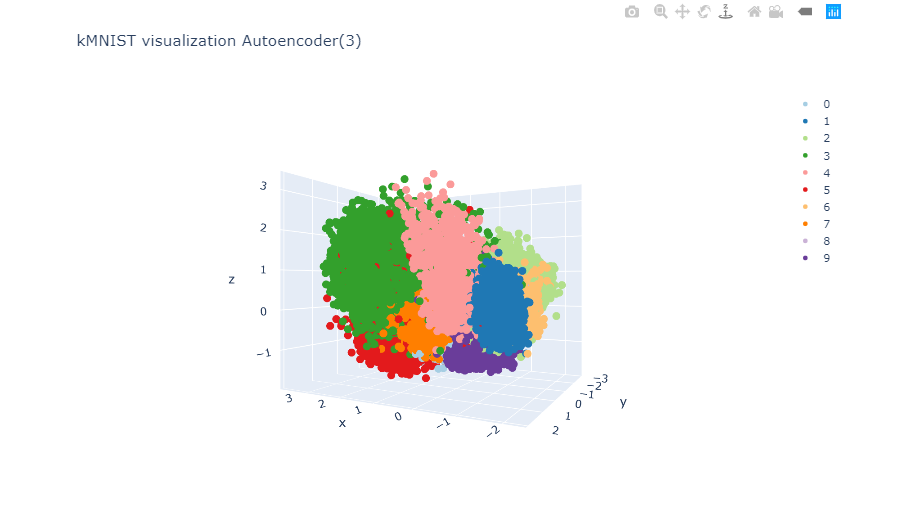

In [307]:
from IPython.display import Image
Image("ae.png")

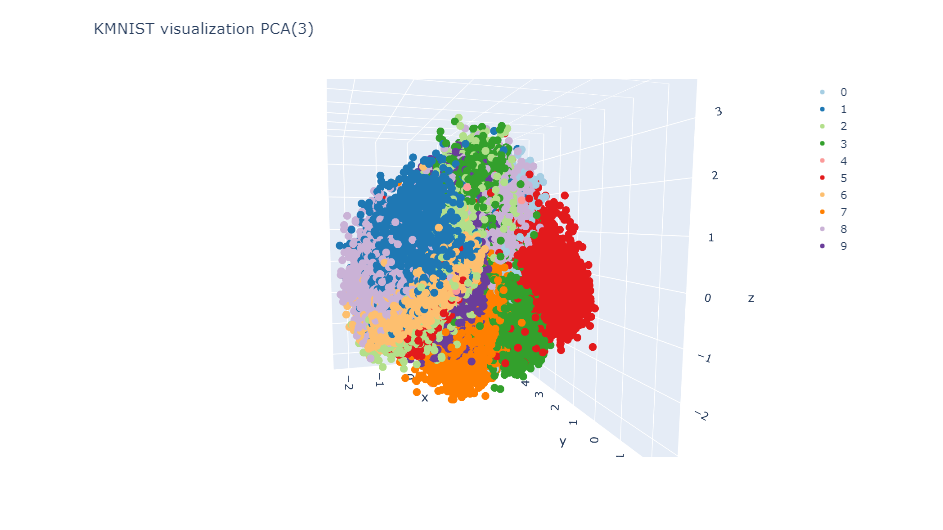

In [224]:
from IPython.display import Image
Image("pca_kmnist.png")


#### 2.4 Get the classification accuracy for the latest features. Use the `KNN` classifier with any hyperparameters you'll choose. Write a couple of sentences comparing the results of `manifold learning` and ` AE`. 

In [310]:
from sklearn.neighbors import KNeighborsClassifier

In [311]:
clf = KNeighborsClassifier(weights='distance', n_jobs=-1)
_x_40_train = net.encoder(x_train.reshape([60000,1, 28, 28])).detach().numpy()
_x_40_test = net.encoder(x_test.reshape([10000,1, 28, 28])).detach().numpy()
clf.fit(_x_40_train, y_train)
print('auto 40:', clf.score(_x_40_test, y_test))

auto 40: 0.9352


In [312]:
clf = KNeighborsClassifier(weights='distance', n_jobs=-1)
_x_3_train = net3.encoder(x_train.reshape([60000,1, 28, 28])).detach().numpy()
_x_3_test = net3.encoder(x_test.reshape([10000,1, 28, 28])).detach().numpy()
clf.fit(_x_3_train, y_train)
print('auto 3:', clf.score(_x_3_test, y_test))

auto 3: 0.6653


In [313]:
# manifold = Isomap(n_neighbors=5, n_components=3)
manifold = PCA(n_components=3)
clf = KNeighborsClassifier(weights='distance', n_jobs=-1)
_x_train = manifold.fit_transform(x_train.reshape([60000,28*28]))
_x_test = manifold.transform(x_test.reshape([10000,28*28]))
clf.fit(_x_train, y_train)
print('manifold 3', clf.score(_x_test, y_test))

manifold 3 0.3721


In [314]:
# manifold = Isomap(n_neighbors=5, n_components=40)
manifold = PCA(n_components=40)
clf = KNeighborsClassifier(weights='distance', n_jobs=-1)
_x_train = manifold.fit_transform(x_train.reshape([60000,28*28]))
_x_test = manifold.transform(x_test.reshape([10000,28*28]))
clf.fit(_x_train, y_train)
print('manifold 40', clf.score(_x_test, y_test))

manifold 40 0.9337


### I think AE get better result with very less bottleneck(we can see it from 3 components visualisation and accuracy scores). But AE can take a lot of time, while we can compute PCA relatively fast. When we increase number of component and bottleneck result seems very comparable, and so I think it can be better use AE with very small number of component and manifold learning (for example PCA, ISOMAP) when you want reduce dimensional not so much 

### BONUS: Sampling from latent space. (3 points)

Imagine, that you want to generate images, using you AE. To do that, you need to sample from the latent space and then decode the result. Of course, we do not know the exact distribution of the latent space. Therefore, let us assume that latent space distribution is Gaussian:

* Encode all the training images into the latent space
* Calculate mean and covariance matrix ($\mu$ and $\Sigma$)
* Sample  $z$ from the $\mathcal{N}(\mu, \Sigma)$
* Decode $z$ from the previous step to obtain an image

Using the procedure described above, sample 10 images and plot them (they should be similar to those of the initial dataset)

In [315]:
m = np.mean(_x_40_train, axis=0)
m

array([ 0.45267212, -0.4110497 ,  0.41708043, -0.06103181, -0.80110174,
       -0.09308299,  0.2895695 ,  0.33692327,  0.10919146, -0.33296528,
        0.31085214, -0.13825896, -0.02866974, -0.07042831, -0.33349827,
        0.17895101, -0.14633934, -0.22985847,  0.3441274 , -0.17209795,
       -0.05083959,  0.08821813, -0.43289998, -0.06487437,  0.21410301,
       -0.5047747 , -0.8217398 , -0.17608733,  0.5250928 , -0.10214719,
        0.3460132 , -0.22626726,  0.2730701 ,  0.33141395, -0.32647353,
        0.01176218, -0.26379248, -0.04589213, -0.00924779, -0.0547111 ],
      dtype=float32)

In [316]:
s = np.std(_x_40_train, axis=0)
s

array([0.73781264, 1.0167067 , 0.7276794 , 0.6884943 , 0.85518014,
       0.85244834, 0.9121195 , 0.73480135, 0.8832829 , 0.8111112 ,
       0.8889399 , 0.8160688 , 0.7978797 , 0.7318566 , 0.96829903,
       0.7441376 , 0.6754494 , 1.0051416 , 0.65267444, 0.7607587 ,
       0.82224154, 0.7817909 , 0.770632  , 0.7177245 , 0.7617022 ,
       0.72434944, 0.8037911 , 1.1805327 , 0.8895016 , 1.4424806 ,
       0.7568746 , 0.6715203 , 0.8004861 , 0.8443729 , 0.864192  ,
       1.0378152 , 0.86789364, 0.76925296, 1.4109026 , 0.6494004 ],
      dtype=float32)

In [317]:
np.random.normal(loc=m,scale=s)

array([ 1.2145433 , -1.42241544,  1.47602899, -0.28532862, -1.43298005,
       -0.76327015,  0.54754455,  0.56152858,  0.29882435, -0.55781772,
        0.66272679, -1.2179633 , -0.71515789, -0.27734848, -0.66024538,
        1.30812839, -1.05191166, -1.00919287, -0.05338816,  0.14353355,
        0.04317571,  0.58529223, -1.2181704 , -0.24220804,  1.61449189,
       -0.28786166, -1.92957968, -1.24267254,  1.45122545, -1.31108944,
        0.28633527, -1.071921  ,  0.33190788, -0.70143889, -0.32284231,
        0.52610947,  0.67296379,  0.24960919, -0.75510557, -0.62884044])

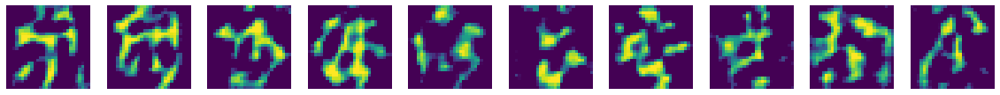

In [318]:
fig, ax = plt.subplots(ncols=10, nrows=1, figsize=(20, 5))
for i in range(10):
    im = np.random.normal(loc=m,scale=s)
    out = net.decoder(torch.tensor(im, dtype=torch.float32).reshape(1,40)).detach().numpy()
    ax[i].imshow(out.reshape(28,28));
    ax[i].axis('off')

**Yeah, so you can get more than `100%` for the homework, good luck!**